In [ ]:
!pip install librosa==0.8.1
!pip install librosa matplotlib 

C:\Users\MAX10\Anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,
Animation size has reached 20988669 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


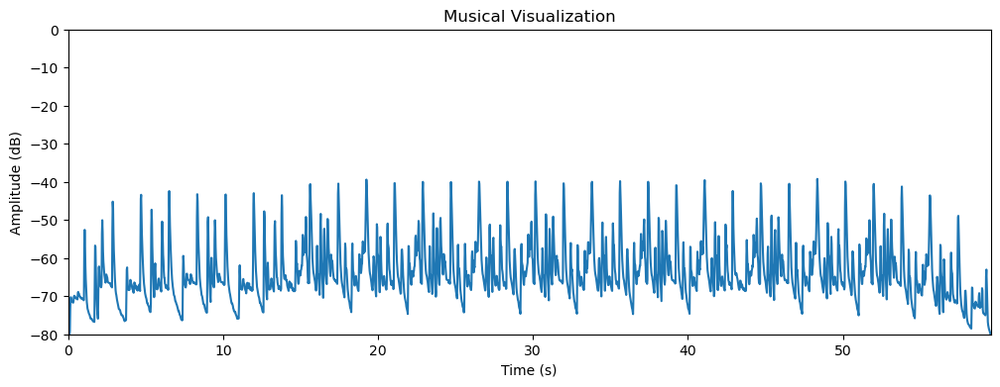

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

# Load the audio file
audio_path = 'C:/Users/MAX10/Documents/GitHub/Music Visualization/1 Minute Timer Relaxing Music Lofi Fish Background.wav'
audio, sr = librosa.load(audio_path)

# Compute the mel spectrogram
hop_length = 512
n_fft = 2048
mel_spec = librosa.feature.melspectrogram(audio, sr=sr, hop_length=hop_length, n_fft=n_fft)
mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)

# Compute the timestamps for each frame
timestamps = librosa.frames_to_time(np.arange(mel_spec.shape[1]), sr=sr, hop_length=hop_length)

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(12, 4))
ax.set(xlim=[timestamps[0], timestamps[-1]], ylim=[np.min(mel_spec_db), np.max(mel_spec_db)])
ax.set_xlabel('Time (s)')
ax.set_ylabel('Amplitude (dB)')
ax.set_title('Musical Visualization')

# Create the line
line, = ax.plot([], [])

# Function to update the line for each frame
def update(frame):
    line.set_data(timestamps[:frame], mel_spec_db[:, :frame].mean(axis=0))

# Create the animation
animation = FuncAnimation(fig, update, frames=range(mel_spec.shape[1]), interval=50)

# Display the animation
HTML(animation.to_jshtml())


In [ ]:
from tqdm import tqdm

In [ ]:
%matplotlib inline
from matplotlib import animation, rc
rc('animation', html='html5')

import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
from matplotlib.animation import FuncAnimation

# Load the audio file
audio_path = 'C:/Users/MAX10/Documents/GitHub/Music Visualization/1 Minute Timer Relaxing Music Lofi Fish Background.wav'
audio, sr = librosa.load(audio_path)

# Compute the spectrogram
hop_length = 512
n_fft = 2048
spectrogram = np.abs(librosa.stft(audio, hop_length=hop_length, n_fft=n_fft))

# Convert amplitude to dB scale
spectrogram_db = librosa.amplitude_to_db(spectrogram, ref=np.max)

# Get the timestamps of each frame
timestamps = librosa.frames_to_time(np.arange(spectrogram.shape[1]), sr=sr, hop_length=hop_length)

# Set up the figure and axis
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, polar=True)
line, = ax.plot([], [], color='blue')

# Function to update the plot for each frame
def update(frame):
    ax.clear()

    # Compute the average amplitude for the current frame
    average_amplitude = np.mean(spectrogram_db[:, frame])

    # Compute the angles for circular visualization
    angles = 2 * np.pi * timestamps[frame]

    # Compute the radius based on the average amplitude
    radius = np.abs(average_amplitude)

    # Update the plot
    line.set_data(angles, radius)
    ax.plot(angles, radius, color='blue')
    ax.fill(angles, radius, alpha=0.25)

    # Set the title and hide the grid
    ax.set_title('Circular Waveform Visualization')
    ax.grid(False)

    # Set the x-axis to start from the top
    ax.set_theta_zero_location('N')

    # Set the y-axis limits
    ax.set_ylim(0, np.max(spectrogram_db))

# Create the animation
animation = FuncAnimation(fig, update, frames=range(spectrogram_db.shape[1]), interval=50)

animation.save('animation.gif', writer='pillow')

# Show the plot
plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

# Load the audio file
audio_path = 'C:/Users/MAX10/Documents/GitHub/Music Visualization/Journey Soundtrack (Austin Wintory) - 17. Apotheosis.wav'
audio, sr = librosa.load(audio_path)

# Compute the spectrogram
hop_length = 512
n_fft = 2048
spectrogram = np.abs(librosa.stft(audio, hop_length=hop_length, n_fft=n_fft))

# Convert amplitude to dB scale
spectrogram_db = librosa.amplitude_to_db(spectrogram, ref=np.max)

# Get the timestamps of each frame
timestamps = librosa.frames_to_time(np.arange(spectrogram.shape[1]), sr=sr, hop_length=hop_length)

# Set up the figure and axis
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, polar=True)
line, = ax.plot([], [], color='blue')

# Function to update the plot for each frame
def update(frame):
    ax.clear()

    # Compute the average amplitude for the current frame
    average_amplitude = np.mean(spectrogram_db[:, frame])

    # Compute the angles for circular visualization
    angles = 2 * np.pi * timestamps[frame]

    # Compute the radius based on the average amplitude
    radius = np.abs(average_amplitude)

    # Update the plot
    line.set_data(angles, radius)
    ax.plot(angles, radius, color='blue')
    ax.fill(angles, radius, alpha=0.25)

    # Set the title and hide the grid
    ax.set_title('Circular Waveform Visualization')
    ax.grid(False)

    # Set the x-axis to start from the top
    ax.set_theta_zero_location('N')

    # Set the y-axis limits
    max_value = np.max(spectrogram_db)
    if max_value == 0:
        max_value = 1e-10  # Set a small non-zero value
    ax.set_ylim(0, max_value)

# Create the animation
animation = FuncAnimation(fig, update, frames=range(spectrogram_db.shape[1]), interval=50)

# Set the MovieWriter to 'pillow'
animation.save('animation.gif', writer='pillow')

# Display the animation
plt.show()
